# Time Stepping for the Advection equation

The equation is given by:


The advection equation is given by:

$$
\frac{\partial u}{\partial t} = \frac{\partial u}{\partial x} + f(x,t)
$$

where:
- u is the quantity being advected,
- t is time,
- x is the spatial coordinate,
- f(x,t) is the forcing term

┌ Info: Saved animation to c:\Users\rimaz\Desktop\sediment-transport\Duffing Equation\Time Stepping\advection_animation.gif
└ @ Plots C:\Users\rimaz\.julia\packages\Plots\kLeqV\src\animation.jl:156


Plots.AnimatedGif("c:\\Users\\rimaz\\Desktop\\sediment-transport\\Duffing Equation\\Time Stepping\\advection_animation.gif")
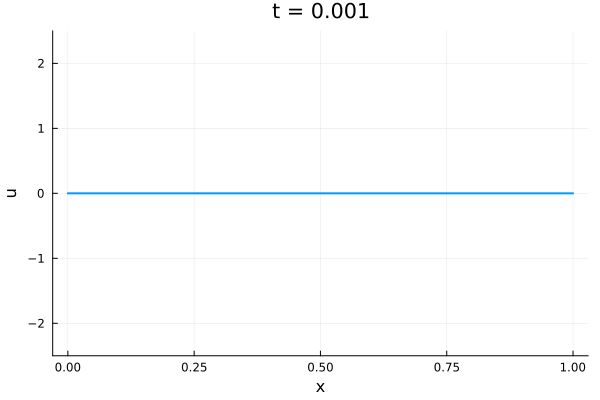

In [9]:
using LinearAlgebra
using SparseArrays
using Plots

# Parameters
Nx = 200              # Number of spatial points
L = 1.0              # Domain length
dx = L/(Nx-1)        # Spatial step
x = range(0, L, Nx)  # Spatial grid
dt = 0.001           # Time step
T = 6           # Final time
ω = 1             # Angular frequency for forcing

# Initialize solution
u = zeros(Nx)        # Current solution
u_new = zeros(Nx)    # Solution at next time step

# Build system matrix for implicit Euler
A = spzeros(Nx, Nx)
for i in 2:Nx-1
    A[i,i-1] = -1/(2dx)
    A[i,i+1] = 1/(2dx)
end

# System matrix setup
I_mat = sparse(I, Nx, Nx)
M = I_mat + dt*A

# Enforce Dirichlet BCs
M[1,:] .= 0.0
M[1,1] = 1.0
M[Nx,:] .= 0.0
M[Nx,Nx] = 1.0

# Time integration with animation
nsteps = Int(T/dt)
anim = @animate for n in 1:nsteps
    t = n*dt
    
    # Forcing term
    f = sin(ω*t) * ones(Nx)
    f[1] = 0.0
    f[end] = 0.0
    
    # Implicit Euler step
    rhs = u + dt*f
    rhs[1] = 0.0
    rhs[end] = 0.0
    
    # Solve system
    u_new = M\rhs
    u .= u_new
    
    # Create plot frame
    plot(x, u, 
        xlabel="x", 
        ylabel="u", 
        title="t = $(round(t,digits=3))",
        ylim=(-2.5,2.5),  # Fixed y-axis limits
        legend=false,
        lw=2
    )
end every 10  # Capture every 10th frame for smoother animation

# Save animation
gif(anim, "advection_animation.gif", fps=30)
